# **Team 1 - Understanding Guest Experience: A Text Mining Approach to  Review Analysis for Hotel Industry.**

# **1. Sentiment Analysis** https://drive.google.com/file/d/1wEjpvOeT4E95kJfi0qOtzpw76MMtOzIX/view?usp=drive_link

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re
import random
from collections import Counter
from wordcloud import WordCloud

import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

from sklearn.utils import resample
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import LogisticRegression
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.preprocessing import LabelEncoder

import lime
import lime.lime_text


In [ ]:
!pip install lime # Install the lime package
!pip install gensim # for broad themes

In [ ]:
# Download necessary NLTK resources
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('punkt_tab')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


True

## Data Preprocessing

In [ ]:
# Load dataset
df = pd.read_csv("Hotel_Reviews.csv")
df.head()

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Ireland,No Negative,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,210,1403,Great location in nice surroundings the bar a...,26,1,3.8,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days,52.360576,4.915968
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/24/2017,7.7,Hotel Arena,New Zealand,You When I booked with your company on line y...,140,1403,Amazing location and building Romantic setting,8,3,6.7,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days,52.360576,4.915968


In [ ]:
# Replace "No Positive" and "No Negative" values with empty strings
df.loc[df['Positive_Review'] == 'No Positive', 'Positive_Review'] = ''
df.loc[df['Negative_Review'] == 'No Negative', 'Negative_Review'] = ''

# Merge positive and negative reviews into a single column
df['Review'] = df['Negative_Review'] + df['Positive_Review']
df.head()

,Hotel_Address,Additional_Number_of_Scoring,Review_Date,Average_Score,Hotel_Name,Reviewer_Nationality,Negative_Review,Review_Total_Negative_Word_Counts,Total_Number_of_Reviews,Positive_Review,Review_Total_Positive_Word_Counts,Total_Number_of_Reviews_Reviewer_Has_Given,Reviewer_Score,Tags,days_since_review,lat,lng,Review
0,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Russia,I am so angry that i made this post available...,397,1403,Only the park outside of the hotel was beauti...,11,7,2.9,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968,I am so angry that i made this post available...
1,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,8/3/2017,7.7,Hotel Arena,Ireland,,0,1403,No real complaints the hotel was great great ...,105,7,7.5,"[' Leisure trip ', ' Couple ', ' Duplex Double...",0 days,52.360576,4.915968,No real complaints the hotel was great great ...
2,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,Australia,Rooms are nice but for elderly a bit difficul...,42,1403,Location was good and staff were ok It is cut...,21,9,7.1,"[' Leisure trip ', ' Family with young childre...",3 days,52.360576,4.915968,Rooms are nice but for elderly a bit difficul...
3,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/31/2017,7.7,Hotel Arena,United Kingdom,My room was dirty and I was afraid to walk ba...,210,1403,Great location in nice surroundings the bar a...,26,1,3.8,"[' Leisure trip ', ' Solo traveler ', ' Duplex...",3 days,52.360576,4.915968,My room was dirty and I was afraid to walk ba...
4,s Gravesandestraat 55 Oost 1092 AA Amsterdam ...,194,7/24/2017,7.7,Hotel Arena,New Zealand,You When I booked with your company on line y...,140,1403,Amazing location and building Romantic setting,8,3,6.7,"[' Leisure trip ', ' Couple ', ' Suite ', ' St...",10 days,52.360576,4.915968,You When I booked with your company on line y...


In [ ]:
# Assign sentiment labels based on review scores
# Reviews with scores below 7 are considered "Negative", otherwise "Positive"
df['Sentiment'] = df['Reviewer_Score'].apply(lambda x: 'Negative' if x < 7 else 'Positive')

# Keep relevant columns and retain original index
df = df.reset_index()

# Create a new DataFrame containing only the review text and sentiment label
data_df = df[['index', 'Review', 'Sentiment']]
data_df.head()

,index,Review,Sentiment
0,0,I am so angry that i made this post available...,Negative
1,1,No real complaints the hotel was great great ...,Positive
2,2,Rooms are nice but for elderly a bit difficul...,Positive
3,3,My room was dirty and I was afraid to walk ba...,Negative
4,4,You When I booked with your company on line y...,Negative


### Data Exploration and Balancing

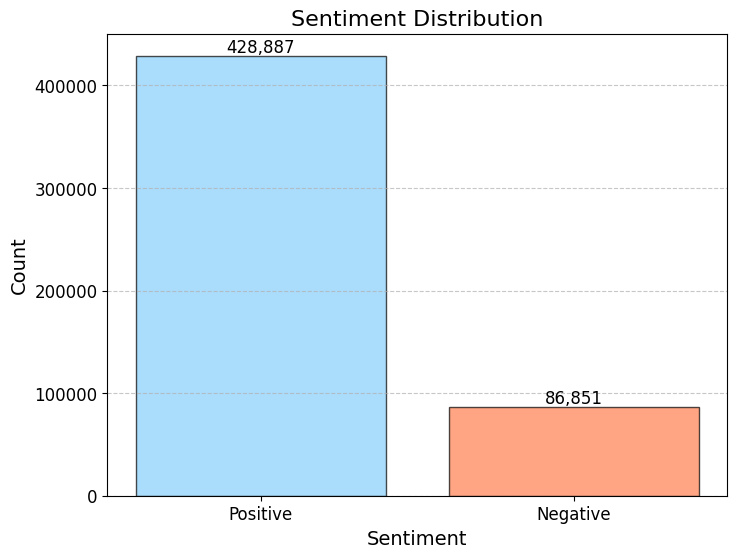

In [ ]:
# Function to visualize sentiment distribution
def plot_label_counts(data, offset=1000, title="Sentiment Distribution"):
    # Explicitly define the sentiment order to prevent unexpected swapping
    sentiment_order = ['Positive', 'Negative']

    # Count sentiment values, ensuring fixed order
    label_counts = data['Sentiment'].value_counts().reindex(sentiment_order)

    # Define a fixed color mapping for each sentiment
    color_dict = {'Positive': 'lightskyblue', 'Negative': 'coral'}
    bar_colors = [color_dict[label] for label in sentiment_order]

    # Plot the bar chart with the defined order and colors
    plt.figure(figsize=(8, 6))
    bars = plt.bar(sentiment_order, label_counts.values,
                   color=bar_colors, alpha=0.7, edgecolor='black')

    # Add count labels on top of each bar
    for bar in bars:
        plt.text(bar.get_x() + bar.get_width()/2, bar.get_height() + offset, f'{bar.get_height():,}',
                 ha='center', fontsize=12)

    # Labeling axes and the plot
    plt.xlabel('Sentiment', fontsize=14)
    plt.ylabel('Count', fontsize=14)
    plt.title(title, fontsize=16)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    # Display plot
    plt.show()

# Visualize sentiment distribution before balancing the dataset
plot_label_counts(data_df, 3000)


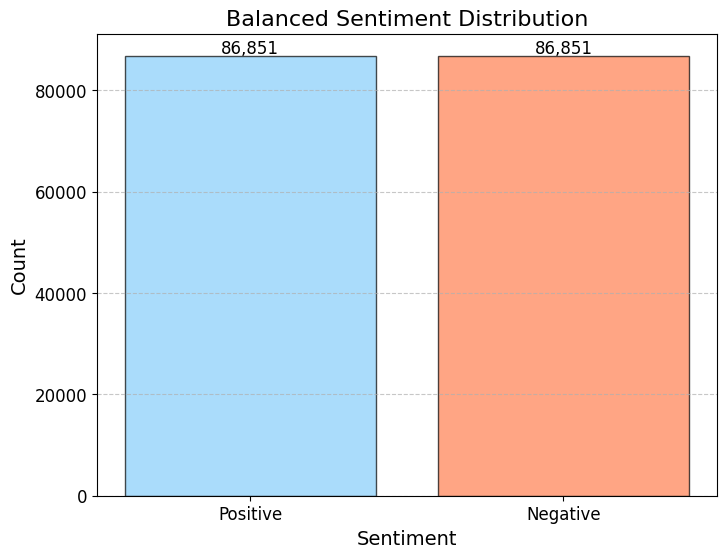

In [ ]:
# Separate the dataset into positive and negative reviews
df_positive = data_df[data_df['Sentiment'] == 'Positive']
df_negative = data_df[data_df['Sentiment'] == 'Negative']

# Check if resampling is needed (only if positive reviews outnumber negative reviews)
if len(df_positive) > len(df_negative):
    # Downsample the majority class (Positive) to match the number of negative reviews
    df_positive_downsampled = resample(df_positive,
                                       replace=False,
                                       n_samples=len(df_negative),  # Match negative class size
                                       random_state=42)

    # Combine the downsampled positive reviews with the negative reviews
    data_df_balanced = pd.concat([df_positive_downsampled, df_negative])

else:
    # If already balanced, no need to downsample
    data_df_balanced = data_df.copy()

# Shuffle dataset to prevent ordering bias
data_df_balanced = data_df_balanced.sample(frac=1, random_state=42).reset_index(drop=True)

# Visualize sentiment distribution after balancing the dataset
plot_label_counts(data_df_balanced, 500, title="Balanced Sentiment Distribution")


### Text Preprocessing

In [ ]:
# Initialize lemmatizer and stopwords
lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words('english'))


def preprocess_text(text):
   text = text.lower()  # Convert to lowercase
   text = re.sub(r'\d+', '', text)  # Remove numbers
   text = re.sub(r'[^\w\s]', '', text)  # Remove punctuation
   tokens = word_tokenize(text)  # Tokenize text
   tokens = [lemmatizer.lemmatize(word) for word in tokens if word not in stop_words]  # Lemmatize & remove stopwords
   return " ".join(tokens)


# Apply preprocessing to the reviews
data_df_balanced['Cleaned_Review'] = data_df_balanced['Review'].apply(preprocess_text)


### Feature Extraction Using TF-IDF

In [ ]:
# Initialize TF-IDF Vectorizer
vectorizer = TfidfVectorizer(max_features=5000)  # Consider top 5000 words
X = vectorizer.fit_transform(data_df_balanced['Cleaned_Review'])  # Convert text into TF-IDF vectors

# Encode sentiment labels (Positive = 1, Negative = 0)
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
y = le.fit_transform(data_df_balanced['Sentiment'])

# Split dataset into training & testing sets
X_train, X_test, y_train, y_test, idx_train, idx_test = train_test_split(
    X, y, data_df_balanced['index'], test_size=0.2, random_state=42, stratify=y
)

## Model Training & Evaluation

### Naive Bayes

In [ ]:
# Train Multinomial Naive Bayes
nb_model = MultinomialNB()
nb_model.fit(X_train, y_train)

# Predict using Naive Bayes
y_pred_nb = nb_model.predict(X_test)

# Evaluate Naive Bayes
print("Naive Bayes Accuracy:", accuracy_score(y_test, y_pred_nb))
print("\n Naive Bayes Classification Report:\n", classification_report(y_test, y_pred_nb))

Naive Bayes Accuracy: 0.7929247862755822

 Naive Bayes Classification Report:
               precision    recall  f1-score   support

           0       0.79      0.80      0.80     17371
           1       0.80      0.78      0.79     17370

    accuracy                           0.79     34741
   macro avg       0.79      0.79      0.79     34741
weighted avg       0.79      0.79      0.79     34741



### Explainability Using LIME (Naive Bayes Model)

In [ ]:
# LIME Explainability
def explain_with_lime(model, pipeline, X_test, y_test, original_indices, le, data_df_balanced, num_samples=10):
    explainer = lime.lime_text.LimeTextExplainer(class_names=['Negative', 'Positive'])
    random.seed(42)
    sample_indices = random.sample(range(X_test.shape[0]), num_samples)

    for idx in sample_indices:
        original_index = original_indices.iloc[idx]
        sample_text = data_df_balanced[data_df_balanced['index'] == original_index]['Cleaned_Review'].values[0]
        actual_label = le.inverse_transform([y_test[idx]])[0]
        predicted_label = le.inverse_transform(model.predict(X_test[idx]))[0]

        print(f"\n{'-'*60}")
        print(f"Sample Index: {original_index}")
        print(f"Actual Label: {actual_label}")
        print(f"Predicted Label: {predicted_label}")
        print(f"Review Text:\n{sample_text}\n")

        exp = explainer.explain_instance(sample_text, pipeline.predict_proba, num_features=10)
        exp.show_in_notebook(text=sample_text)

In [ ]:
# Create pipelines
pipeline_nb = make_pipeline(vectorizer, nb_model)

# Run LIME explanations
print("\n LIME Explanations for Naive Bayes:")
explain_with_lime(nb_model, pipeline_nb, X_test, y_test, idx_test, le, data_df_balanced)



 LIME Explanations for Naive Bayes:

------------------------------------------------------------
Sample Index: 220075
Actual Label: Negative
Predicted Label: Negative
Review Text:
faculty hotel bad condition spent one full day without hot water heater also witnessed couple time issue elevator manager cooperative upgraded junior suit however hotel need major renovation regular maintenance nothing




------------------------------------------------------------
Sample Index: 127623
Actual Label: Negative
Predicted Label: Positive
Review Text:
size room akin shoe box bed best three quarter size pushed corner two adult uncomfortable resulted much sleep beautifully presented hotel clean modern plenty porter available escort room building across street




------------------------------------------------------------
Sample Index: 185160
Actual Label: Negative
Predicted Label: Negative
Review Text:
hotel loud throughout night midnight someone running construction equipment least minute breakfast excellent hotel great location staff friendly helpful




------------------------------------------------------------
Sample Index: 3563
Actual Label: Positive
Predicted Label: Negative
Review Text:
bathroom shower slippery hand hold attitude staff




------------------------------------------------------------
Sample Index: 475942
Actual Label: Negative
Predicted Label: Negative
Review Text:
enter kitchen disgusting food everything left plate even water expect star hotel right place room look clean really confident would kindly recommend come hotel position




------------------------------------------------------------
Sample Index: 459944
Actual Label: Positive
Predicted Label: Positive
Review Text:
helpful staff perfect location easy access city center staff helped finding lovely hotel really clean nice area would definitely stay




------------------------------------------------------------
Sample Index: 15975
Actual Label: Positive
Predicted Label: Negative
Review Text:
ac room poor room hot try sleep




------------------------------------------------------------
Sample Index: 316021
Actual Label: Negative
Predicted Label: Negative
Review Text:
mediocre hotel value money absolutely unacceptable staff systematically overstrained




------------------------------------------------------------
Sample Index: 241076
Actual Label: Negative
Predicted Label: Negative
Review Text:
like smell room stuff work well lot mistake like location hotel




------------------------------------------------------------
Sample Index: 440299
Actual Label: Positive
Predicted Label: Positive
Review Text:
location hotel rooftop bar pool great service staff would stay sure



### Logistic Regression

In [ ]:
# Train Logistic Regression
lr_model = LogisticRegression(max_iter=500)
lr_model.fit(X_train, y_train)

# Predict using Logistic Regression
y_pred_lr = lr_model.predict(X_test)

# Evaluate Logistic Regression
print("Logistic Regression Accuracy:", accuracy_score(y_test, y_pred_lr))
print("\n Logistic Regression Classification Report:\n", classification_report(y_test, y_pred_lr))

Logistic Regression Accuracy: 0.8115770991048041

 Logistic Regression Classification Report:
               precision    recall  f1-score   support

           0       0.81      0.82      0.81     17371
           1       0.82      0.80      0.81     17370

    accuracy                           0.81     34741
   macro avg       0.81      0.81      0.81     34741
weighted avg       0.81      0.81      0.81     34741



### Explainability Using LIME (Logistic Regression Model)

In [ ]:
# Create pipelines
pipeline_lr = make_pipeline(vectorizer, lr_model)
print("\n LIME Explanations for Logistic Regression:")

# Run LIME explanations
explain_with_lime(lr_model, pipeline_lr, X_test, y_test, idx_test, le, data_df_balanced)


 LIME Explanations for Logistic Regression:

------------------------------------------------------------
Sample Index: 220075
Actual Label: Negative
Predicted Label: Negative
Review Text:
faculty hotel bad condition spent one full day without hot water heater also witnessed couple time issue elevator manager cooperative upgraded junior suit however hotel need major renovation regular maintenance nothing




------------------------------------------------------------
Sample Index: 127623
Actual Label: Negative
Predicted Label: Negative
Review Text:
size room akin shoe box bed best three quarter size pushed corner two adult uncomfortable resulted much sleep beautifully presented hotel clean modern plenty porter available escort room building across street




------------------------------------------------------------
Sample Index: 185160
Actual Label: Negative
Predicted Label: Positive
Review Text:
hotel loud throughout night midnight someone running construction equipment least minute breakfast excellent hotel great location staff friendly helpful




------------------------------------------------------------
Sample Index: 3563
Actual Label: Positive
Predicted Label: Negative
Review Text:
bathroom shower slippery hand hold attitude staff




------------------------------------------------------------
Sample Index: 475942
Actual Label: Negative
Predicted Label: Negative
Review Text:
enter kitchen disgusting food everything left plate even water expect star hotel right place room look clean really confident would kindly recommend come hotel position




------------------------------------------------------------
Sample Index: 459944
Actual Label: Positive
Predicted Label: Positive
Review Text:
helpful staff perfect location easy access city center staff helped finding lovely hotel really clean nice area would definitely stay




------------------------------------------------------------
Sample Index: 15975
Actual Label: Positive
Predicted Label: Negative
Review Text:
ac room poor room hot try sleep




------------------------------------------------------------
Sample Index: 316021
Actual Label: Negative
Predicted Label: Negative
Review Text:
mediocre hotel value money absolutely unacceptable staff systematically overstrained




------------------------------------------------------------
Sample Index: 241076
Actual Label: Negative
Predicted Label: Negative
Review Text:
like smell room stuff work well lot mistake like location hotel




------------------------------------------------------------
Sample Index: 440299
Actual Label: Positive
Predicted Label: Positive
Review Text:
location hotel rooftop bar pool great service staff would stay sure



### Confusion Matrices

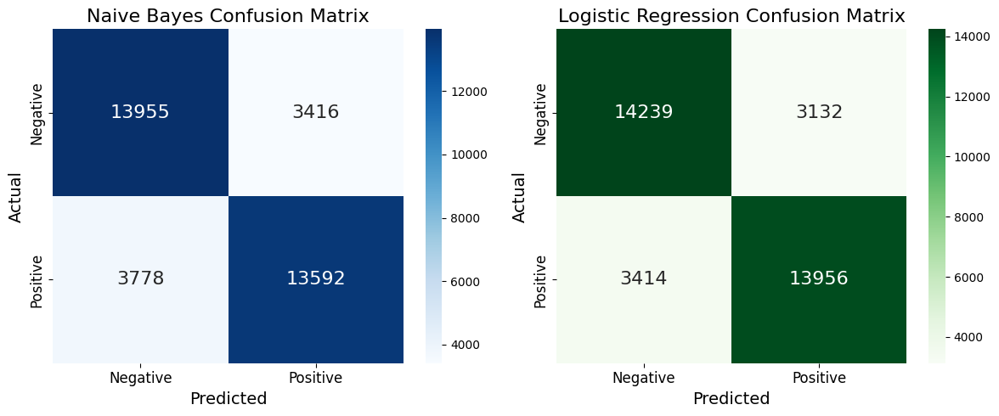

In [ ]:
# Plot confusion matrices
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# Naive Bayes Confusion Matrix
sns.heatmap(confusion_matrix(y_test, y_pred_nb), annot=True, fmt="d", cmap="Blues",
            xticklabels=['Negative', 'Positive'], yticklabels=['Negative', 'Positive'],
            annot_kws={"size": 16}, ax=axes[0])
axes[0].set_title("Naive Bayes Confusion Matrix", fontsize=16)
axes[0].set_xlabel("Predicted", fontsize=14)
axes[0].set_ylabel("Actual", fontsize=14)
axes[0].tick_params(axis='both', labelsize=12)

# Logistic Regression Confusion Matrix
sns.heatmap(confusion_matrix(y_test, y_pred_lr), annot=True, fmt="d", cmap="Greens",
            xticklabels=['Negative', 'Positive'], yticklabels=['Negative', 'Positive'],
            annot_kws={"size": 16}, ax=axes[1])
axes[1].set_title("Logistic Regression Confusion Matrix", fontsize=16)
axes[1].set_xlabel("Predicted", fontsize=14)
axes[1].set_ylabel("Actual", fontsize=14)
axes[1].tick_params(axis='both', labelsize=12)

plt.tight_layout()
plt.show()


# **2. Topic Modelling & Key Theme Extraction**

## Extracting Common Themes in Positive & Negative Reviews

In [ ]:
# Apply preprocessing to reviews
from sklearn.decomposition import LatentDirichletAllocation # Import LatentDirichletAllocation

data_df_balanced['Cleaned_Review'] = data_df_balanced['Review'].apply(preprocess_text)

# Separate positive and negative reviews
positive_reviews = data_df_balanced[data_df_balanced['Sentiment'] == 'Positive']['Cleaned_Review']
negative_reviews = data_df_balanced[data_df_balanced['Sentiment'] == 'Negative']['Cleaned_Review']

# Convert to document-term matrix
vectorizer_positive = TfidfVectorizer(max_features=5000)
X_positive = vectorizer_positive.fit_transform(positive_reviews)

vectorizer_negative = TfidfVectorizer(max_features=5000)
X_negative = vectorizer_negative.fit_transform(negative_reviews)

# Train LDA models
lda_positive = LatentDirichletAllocation(n_components=5, random_state=42)
lda_negative = LatentDirichletAllocation(n_components=5, random_state=42)

lda_positive.fit(X_positive)
lda_negative.fit(X_negative)

def extract_topics(model, vectorizer, top_n=10):
    words = vectorizer.get_feature_names_out()
    topics = {}
    for i, topic in enumerate(model.components_):
        topics[f"Topic {i+1}"] = [words[i] for i in topic.argsort()[:-top_n - 1:-1]]
    return topics

# Extract topics
positive_topics = extract_topics(lda_positive, vectorizer_positive)
negative_topics = extract_topics(lda_negative, vectorizer_negative)

print("Positive Review Topics:")
for topic, words in positive_topics.items():
    print(f"{topic}: {', '.join(words)}")

print("\nNegative Review Topics:")
for topic, words in negative_topics.items():
    print(f"{topic}: {', '.join(words)}")

Positive Review Topics:
Topic 1: room, bed, small, location, bathroom, good, comfortable, staff, breakfast, clean
Topic 2: station, close, hotel, location, good, walk, metro, great, room, city
Topic 3: room, breakfast, staff, hotel, check, free, bar, bed, day, good
Topic 4: location, staff, nothing, great, friendly, everything, breakfast, excellent, helpful, good
Topic 5: room, hotel, staff, air, location, good, breakfast, helpful, great, friendly

Negative Review Topics:
Topic 1: room, hotel, staff, check, booking, nothing, time, one, day, told
Topic 2: room, breakfast, staff, location, good, hotel, bar, bed, need, food
Topic 3: hotel, room, location, star, good, breakfast, staff, station, close, nice
Topic 4: room, air, noise, noisy, window, location, bed, bathroom, shower, night
Topic 5: location, room, small, staff, breakfast, bed, good, poor, service, size


## Word Cloud Visualisation

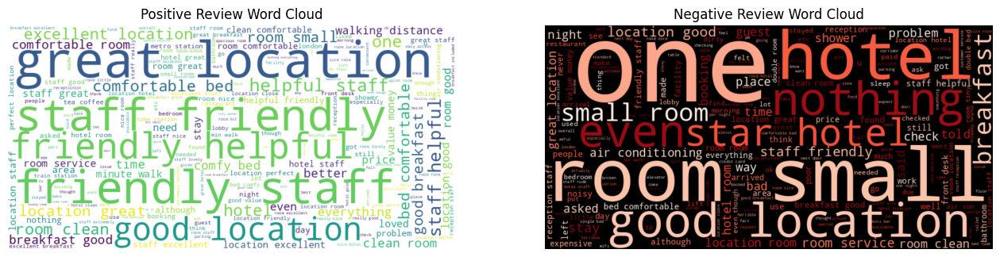

In [ ]:
# Generate word cloud for positive reviews
positive_wordcloud = WordCloud(width=800, height=400, background_color="white").generate(" ".join(positive_reviews))

# Generate word cloud for negative reviews
negative_wordcloud = WordCloud(width=800, height=400, background_color="black", colormap="Reds").generate(" ".join(negative_reviews))

# Plot word clouds
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

axes[0].imshow(positive_wordcloud, interpolation='bilinear')
axes[0].set_title("Positive Review Word Cloud")
axes[0].axis("off")

axes[1].imshow(negative_wordcloud, interpolation='bilinear')
axes[1].set_title("Negative Review Word Cloud")
axes[1].axis("off")

plt.show()


## Extract top words from positive topics

In [ ]:
# Extract top words from positive topics
# Ensure lda_positive and lda_negative are defined from previous cells
from sklearn.decomposition import LatentDirichletAllocation # Import LatentDirichletAllocation
from sklearn.feature_extraction.text import TfidfVectorizer
import pandas as pd # Import pandas
from sklearn.utils import resample # Import the resample function
import re # Import the regular expression library
import nltk # Import NLTK
from nltk.corpus import stopwords # Import the stopwords library
from nltk.tokenize import word_tokenize # Import the word_tokenize function
from nltk.stem import WordNetLemmatizer # Import the WordNetLemmatizer class

# Initialize lemmatizer and stopwords
# This is done here to fix the NameError
lemmatizer = WordNetLemmatizer()
stop_words = set(stopwords.words('english'))

# Load dataset (if not already loaded)
df = pd.read_csv("Hotel_Reviews.csv")

# ... (rest of your data preprocessing and balancing code from previous cells) ...
# Replace "No Positive" and "No Negative" values with empty strings
df.loc[df['Positive_Review'] == 'No Positive', 'Positive_Review'] = ''
df.loc[df['Negative_Review'] == 'No Negative', 'Negative_Review'] = ''

# Merge positive and negative reviews into a single column
df['Review'] = df['Negative_Review'] + df['Positive_Review']

# Assign sentiment labels based on review scores
# Reviews with scores below 7 are considered "Negative", otherwise "Positive"
df['Sentiment'] = df['Reviewer_Score'].apply(lambda x: 'Negative' if x < 7 else 'Positive')

# Keep relevant columns and retain original index
df = df.reset_index()

# Create a new DataFrame containing only the review text and sentiment label
data_df = df[['index', 'Review', 'Sentiment']]

# ... (rest of your data balancing code) ...
# Separate the dataset into positive and negative reviews
df_positive = data_df[data_df['Sentiment'] == 'Positive']
df_negative = data_df[data_df['Sentiment'] == 'Negative']

# Check if resampling is needed (only if positive reviews outnumber negative reviews)
if len(df_positive) > len(df_negative):
    # Downsample the majority class (Positive) to match the number of negative reviews
    df_positive_downsampled = resample(df_positive,
                                       replace=False,
                                       n_samples=len(df_negative),  # Match negative class size
                                       random_state=42)

    # Combine the downsampled positive reviews with the negative reviews
    data_df_balanced = pd.concat([df_positive_downsampled, df_negative])

else:
    # If already balanced, no need to downsample
    data_df_balanced = data_df.copy()

# Shuffle dataset to prevent ordering bias
data_df_balanced = data_df_balanced.sample(frac=1, random_state=42).reset_index(drop=True)

# Apply preprocessing to reviews
# Define the preprocess_text function here
def preprocess_text(text):
   text = text.lower()  # Convert to lowercase
   text = re.sub(r'\d+', '', text)  # Remove numbers
   text = re.sub(r'[^\w\s]', '', text)  # Remove punctuation
   tokens = word_tokenize(text)  # Tokenize text
   tokens = [lemmatizer.lemmatize(word) for word in tokens if word not in stop_words]  # Lemmatize & remove stopwords
   return " ".join(tokens)

data_df_balanced['Cleaned_Review'] = data_df_balanced['Review'].apply(preprocess_text)

# The variable positive_reviews was not defined, so it needs to be recreated before use
# Separate positive and negative reviews
positive_reviews = data_df_balanced[data_df_balanced['Sentiment'] == 'Positive']['Cleaned_Review']
negative_reviews = data_df_balanced[data_df_balanced['Sentiment'] == 'Negative']['Cleaned_Review']

# Convert to document-term matrix
vectorizer_positive = TfidfVectorizer(max_features=5000)
X_positive = vectorizer_positive.fit_transform(positive_reviews)

vectorizer_negative = TfidfVectorizer(max_features=5000)
X_negative = vectorizer_negative.fit_transform(negative_reviews)

# Train LDA models
lda_positive = LatentDirichletAllocation(n_components=5, random_state=42)
lda_negative = LatentDirichletAllocation(n_components=5, random_state=42)

lda_positive.fit(X_positive)
lda_negative.fit(X_negative)

# Re-define the extract_topics function within the current cell
def extract_topics(model, vectorizer, top_n=10):
    words = vectorizer.get_feature_names_out()
    topics = {}
    for i, topic in enumerate(model.components_):
        topics[f"Topic {i+1}"] = [words[i] for i in topic.argsort()[:-top_n - 1:-1]]
    return topics

positive_topics = extract_topics(lda_positive, vectorizer_positive) # Use the extract_topics function for scikit-learn's LDA
negative_topics = extract_topics(lda_negative, vectorizer_negative) # Use the extract_topics function for scikit-learn's LDA


## keyword-based matching
theme_keywords = {
    "Cleanliness": ["dirty", "clean", "bathroom", "sheets", "smell"],
    "Staff Behavior": ["staff", "rude", "friendly", "helpful", "manager"],
    "Location & Accessibility": ["location", "near", "airport", "downtown", "transport", "station", "walk", "accessible"],
    "Amenities & Facilities": ["wifi", "pool", "gym", "breakfast", "bar", "restaurant", "view", "parking", "air conditioning","internet"],
    "Value for Money": ["price", "value", "expensive", "cheap", "fair", "worth", "cost", "money", "afford"]
}

# Keyword-based topic classification (example)
positive_classified = []
negative_classified = []

for i in range(5):  # Assuming 5 topics
    positive_topic_words = positive_topics[f"Topic {i + 1}"]
    negative_topic_words = negative_topics[f"Topic {i + 1}"]

    # Classify positive topic
    positive_theme = "Other"  # Default theme
    for theme, keywords in theme_keywords.items():
        if any(keyword in positive_topic_words for keyword in keywords):
            positive_theme = theme
            break
    positive_classified.append(positive_theme)

    # Classify negative topic
    negative_theme = "Other"  # Default theme
    for theme, keywords in theme_keywords.items():
        if any(keyword in negative_topic_words for keyword in keywords):
            negative_theme = theme
            break
    negative_classified.append(negative_theme)

# Convert to DataFrame
df_themes = pd.DataFrame({
    "Topic": list(range(5)),
    "Positive Theme": positive_classified,  # Use the defined variables
    "Negative Theme": negative_classified  # Use the defined variables
})

print(df_themes)

   Topic            Positive Theme  Negative Theme
0      0               Cleanliness  Staff Behavior
1      1  Location & Accessibility  Staff Behavior
2      2            Staff Behavior  Staff Behavior
3      3            Staff Behavior     Cleanliness
4      4            Staff Behavior  Staff Behavior


# **3. Hotel Benchmarking**

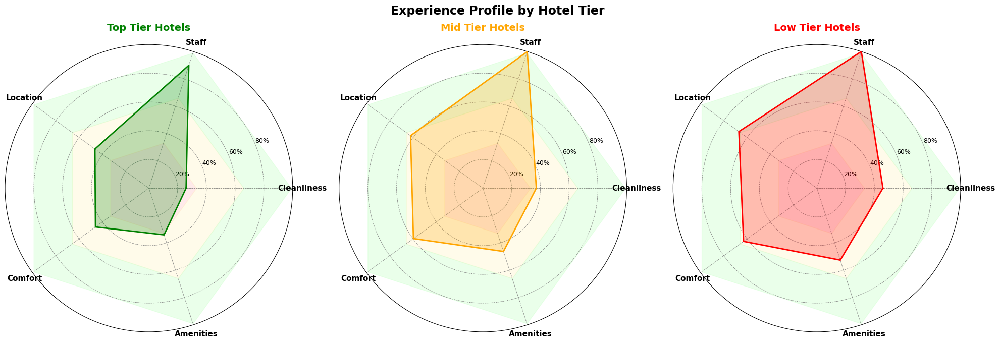

In [ ]:
# Objective 3 start here

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Load & preprocess (use only if not already done)
df = pd.read_csv("Hotel_Reviews.csv")
df['Positive_Review'] = df['Positive_Review'].replace('No Positive', '')
df['Negative_Review'] = df['Negative_Review'].replace('No Negative', '')
df['Sentiment'] = df['Reviewer_Score'].apply(lambda x: 'Negative' if x < 7 else 'Positive')

# Aggregate hotel sentiment
hotel_sentiment_summary = df.groupby(['Hotel_Name', 'Sentiment']).size().unstack(fill_value=0)
hotel_sentiment_summary['Total_Reviews'] = hotel_sentiment_summary.sum(axis=1)
hotel_sentiment_summary['Positive_Percentage'] = (hotel_sentiment_summary['Positive'] / hotel_sentiment_summary['Total_Reviews']) * 100
hotel_sentiment_summary['Tier'] = pd.qcut(hotel_sentiment_summary['Positive_Percentage'], q=3, labels=['Low', 'Mid', 'Top'])

# Themes for radar
themes = {
    'Cleanliness': ['clean', 'dirty', 'hygiene', 'smell', 'bathroom'],
    'Staff': ['staff', 'rude', 'friendly', 'helpful', 'attitude'],
    'Location': ['location', 'central', 'far', 'metro', 'accessible'],
    'Comfort': ['comfortable', 'bed', 'noise', 'quiet', 'spacious'],
    'Amenities': ['wifi', 'breakfast', 'gym', 'internet', 'pool']
}

# Count keyword mentions
def count_theme_keywords(text):
    scores = []
    text = text.lower()
    for keywords in themes.values():
        count = sum(text.count(k) for k in keywords)
        scores.append(count)
    return scores

tier_raw_scores = {}
for tier in ['Top', 'Mid', 'Low']:
    hotels = hotel_sentiment_summary[hotel_sentiment_summary['Tier'] == tier].index
    reviews = df[df['Hotel_Name'].isin(hotels)]
    full_text = " ".join(reviews['Negative_Review'].fillna('') + " " + reviews['Positive_Review'].fillna(''))
    tier_raw_scores[tier] = count_theme_keywords(full_text)

# Normalize globally
all_scores = np.array(list(tier_raw_scores.values()))
global_max = all_scores.max()
tier_scores_normalized = {tier: (np.array(scores) / global_max).tolist() for tier, scores in tier_raw_scores.items()}

# Radar plot setup
labels = list(themes.keys())
angles = np.linspace(0, 2 * np.pi, len(labels), endpoint=False).tolist()
angles += angles[:1]

tier_colors = {
    'Top': 'green',
    'Mid': 'orange',
    'Low': 'red'
}

fig, axes = plt.subplots(1, 3, subplot_kw=dict(polar=True), figsize=(20, 7))
for ax, tier in zip(axes, ['Top', 'Mid', 'Low']):
    scores = tier_scores_normalized[tier] + [tier_scores_normalized[tier][0]]

    # Background bands: red, yellow, green
    for i, color in zip([0.0, 0.33, 0.66], ['#ffcccc', '#fff7cc', '#ccffcc']):
        ax.fill_between(angles, i, i + 0.33, color=color, alpha=0.4, zorder=0)

    # Radar line
    ax.plot(angles, scores, linewidth=2, color=tier_colors[tier], zorder=3)
    ax.fill(angles, scores, alpha=0.25, color=tier_colors[tier], zorder=2)

    # Labels and title
    ax.set_title(f"{tier} Tier Hotels", size=14, weight='bold', color=tier_colors[tier], pad=20)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels, fontsize=11, weight='semibold')
    ax.set_yticks([0.2, 0.4, 0.6, 0.8])
    ax.set_yticklabels(['20%', '40%', '60%', '80%'], fontsize=9)
    ax.set_ylim(0, 1)
    ax.grid(True, linestyle='--', linewidth=0.6, color='gray')

# Supertitle
fig.suptitle("Experience Profile by Hotel Tier", fontsize=17, weight='bold')
plt.tight_layout()
plt.subplots_adjust(top=0.90)
plt.show()

In [ ]:
import pandas as pd
from openai import OpenAI

# STEP 2: Set up OpenAI client
client = OpenAI(api_key="")

# STEP 3: Load and preprocess dataset
df = pd.read_csv("Hotel_Reviews.csv")  # Upload file to Colab
df['Positive_Review'] = df['Positive_Review'].replace('No Positive', '')
df['Negative_Review'] = df['Negative_Review'].replace('No Negative', '')
df['Review'] = df['Negative_Review'].fillna('') + ' ' + df['Positive_Review'].fillna('')
df['Sentiment'] = df['Reviewer_Score'].apply(lambda x: 'Negative' if x < 7 else 'Positive')

# STEP 4: Assign tiers
hotel_sentiment_summary = df.groupby(['Hotel_Name', 'Sentiment']).size().unstack(fill_value=0)
hotel_sentiment_summary['Total_Reviews'] = hotel_sentiment_summary.sum(axis=1)
hotel_sentiment_summary['Positive_Percentage'] = (hotel_sentiment_summary['Positive'] / hotel_sentiment_summary['Total_Reviews']) * 100
hotel_sentiment_summary['Tier'] = pd.qcut(hotel_sentiment_summary['Positive_Percentage'], q=3, labels=['Low', 'Mid', 'Top'])

# STEP 5: Tier-level GPT function with structured headings
def generate_tier_formatted_summary(tier):
    hotels = hotel_sentiment_summary[hotel_sentiment_summary['Tier'] == tier].index
    reviews = df[df['Hotel_Name'].isin(hotels)]['Review'].tolist()
    text = " ".join(reviews)[:8000]  # Limit for GPT input

    prompt = f"""
You are a hospitality benchmarking expert. Analyze the following reviews for {tier}-tier hotels and return your output using this exact format (no emojis):

────────────────────────────────────────────
GPT Analysis: {tier} Tier Hotels
────────────────────────────────────────────

Guest Experience Snapshot

Positives:
- bullet list of things guests like

Negatives:
- bullet list of things guests complain about

Operational Pain Points

- list operational weaknesses recurring across reviews

Priority Recommendations

1. numbered list of smart, specific actions hotels in this tier should take to improve
2. ...
3. ...

Summary:
A concise paragraph (3-4 lines) summarizing what this tier does well, where it struggles, and what can improve its competitive position.

Here are the reviews:
{text}
"""

    response = client.chat.completions.create(
        model="gpt-3.5-turbo",
        messages=[
            {"role": "system", "content": "You are an expert in hotel review summarization and competitive benchmarking."},
            {"role": "user", "content": prompt}
        ]
    )

    return response.choices[0].message.content

# STEP 6: Generate and display results
for tier in ['Low', 'Mid', 'Top']:
    print(generate_tier_formatted_summary(tier))
    print("\n" + "-"*80 + "\n")

────────────────────────────────────────────
GPT Analysis: Low Tier Hotels
────────────────────────────────────────────

Guest Experience Snapshot

Positives:
- Great location
- Beautiful surroundings
- Nice rooms
- Nice park nearby
- Good breakfast quality
- Spacious and bright rooms
- Romantic setting

Negatives:
- Misleading booking information
- Broken windows and appliances
- Noise issues in rooms
- Dirty rooms and maintenance issues
- Confusing staff communication
- Limited restaurant options
- Noisy surroundings
- Problems with cleanliness and service consistency

Operational Pain Points
- Inconsistent cleanliness standards
- Miscommunications regarding room bookings
- Noise disturbances in rooms
- Lack of clarity in booking information
- Maintenance issues and delays

Priority Recommendations

1. Implement stringent cleanliness protocols to ensure rooms are consistently clean and maintained.
2. Provide accurate and transparent booking information to avoid customer confusion.
3.

In [ ]:
from openai import OpenAI
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# ✅ Step 1: Setup OpenAI client
client = OpenAI(api_key="")

# ✅ Step 2: Load and preprocess data
df = pd.read_csv("Hotel_Reviews.csv")
df['Positive_Review'] = df['Positive_Review'].replace('No Positive', '')
df['Negative_Review'] = df['Negative_Review'].replace('No Negative', '')
df['Review'] = df['Negative_Review'].fillna('') + ' ' + df['Positive_Review'].fillna('')
df['Sentiment'] = df['Reviewer_Score'].apply(lambda x: 'Negative' if x < 7 else 'Positive')

# ✅ Step 3: Assign sentiment-based tiers
hotel_sentiment_summary = df.groupby(['Hotel_Name', 'Sentiment']).size().unstack(fill_value=0)
hotel_sentiment_summary['Total_Reviews'] = hotel_sentiment_summary.sum(axis=1)
hotel_sentiment_summary['Positive_Percentage'] = (
    hotel_sentiment_summary['Positive'] / hotel_sentiment_summary['Total_Reviews']
) * 100
hotel_sentiment_summary['Tier'] = pd.qcut(
    hotel_sentiment_summary['Positive_Percentage'], q=3, labels=['Low', 'Mid', 'Top']
)

# ✅ Step 4: CLI + GPT + Radar
def generate_hotel_summary_cli():
    hotel_name = input("Enter a hotel name: ").strip()

    if hotel_name not in df['Hotel_Name'].unique():
        print("❌ Hotel not found in the dataset.")
        return

    # 🧾 Extract reviews
    hotel_reviews = df[df['Hotel_Name'] == hotel_name]
    review_text = " ".join(hotel_reviews['Review'].tolist())[:4000]

    # 🧠 Metadata
    tier = hotel_sentiment_summary.loc[hotel_name]['Tier']
    pos_pct = hotel_sentiment_summary.loc[hotel_name]['Positive_Percentage']
    avg_pct = hotel_sentiment_summary[hotel_sentiment_summary['Tier'] == tier]['Positive_Percentage'].mean()
    standing = "above average" if pos_pct > avg_pct else "below average"

    # 📦 GPT Prompt
    prompt = f"""
You are a hotel benchmarking expert. The hotel name is "{hotel_name}" which belongs to the {tier} tier.

This hotel has a positive review rate of {pos_pct:.2f}%, which is {standing} compared to its tier average of {avg_pct:.2f}%.

Analyze the following guest reviews and return the result using this format exactly (no emojis):

────────────────────────────────────────────
GPT Analysis: {hotel_name} ({tier} Tier)
────────────────────────────────────────────

Guest Experience Snapshot

Positives:
- List positive themes mentioned by guests

Negatives:
- List recurring complaints or frustrations

Operational Pain Points
- Identify 3–5 critical recurring issues from operations/service/delivery

Priority Recommendations
1. Smart, actionable fix #1
2. Smart, actionable fix #2
3. Smart, actionable fix #3
...

Summary:
Briefly summarize where this hotel excels, what issues hurt guest satisfaction, and what improvements are likely to help it outperform others in the same tier.

Here are the reviews:
{review_text}
"""

    # 🔁 GPT Call
    response = client.chat.completions.create(
        model="gpt-3.5-turbo",
        messages=[
            {"role": "system", "content": "You are a hospitality analyst generating structured hotel performance evaluations."},
            {"role": "user", "content": prompt}
        ]
    )

    print("\n" + response.choices[0].message.content)

    # 🎯 Radar Chart Themes
    themes = {
        'Cleanliness': ['clean', 'dirty', 'smell'],
        'Staff': ['staff', 'rude', 'friendly'],
        'Location': ['location', 'metro', 'access'],
        'Comfort': ['comfortable', 'bed', 'noise'],
        'Amenities': ['wifi', 'breakfast', 'internet']
    }

    # ✏️ Score each category
    combined_text = " ".join(hotel_reviews['Review'].tolist()).lower()
    scores = [sum(combined_text.count(k) for k in keywords) for keywords in themes.values()]
    max_score = max(scores) or 1
    scores = [s / max_score for s in scores]

    # 🕸️ Radar setup
    labels = list(themes.keys())
    angles = np.linspace(0, 2 * np.pi, len(labels), endpoint=False).tolist()
    scores += scores[:1]
    angles += angles[:1]

    fig, ax = plt.subplots(figsize=(7, 7), subplot_kw=dict(polar=True))

    # 🎨 Fill zones by score (color-coded)
    for i in range(len(labels)):
        color = 'red' if scores[i] < 0.4 else ('yellow' if scores[i] < 0.7 else 'green')
        ax.fill(
            [angles[i], angles[i+1], 0],  # triangle from point to center
            [scores[i], scores[i+1], 0],
            color=color,
            alpha=0.25
        )

    # 📈 Overlay actual line
    ax.plot(angles, scores, color='teal', linewidth=2)
    ax.fill(angles, scores, color='teal', alpha=0.15)

    # 🧾 Labeling
    ax.set_title(f"{hotel_name} – Guest Experience Profile", fontsize=15, pad=30)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(labels, fontsize=12)
    ax.set_yticklabels([])
    ax.set_rlabel_position(30)
    ax.set_ylim(0, 1)
    ax.grid(True, linestyle='--', linewidth=0.6)

    plt.tight_layout()
    plt.show()

# ✅ Run this to activate:
# generate_hotel_summary_cli()

Enter a hotel name: Kingsway Hall Hotel


────────────────────────────────────────────
GPT Analysis: Kingsway Hall Hotel (Mid Tier)
────────────────────────────────────────────

Guest Experience Snapshot

Positives:
- Hotel is located near theatres and shopping areas
- Helpful and friendly staff
- Safe environment for solo female travelers
- Small but enjoyable spa area
- Comfortable beds and clean rooms
- Useful handheld device for sightseeing
- Great location for accessing attractions and the West End
- Pleasant and accommodating concierge service

Negatives:
- Inconsistent room amenities, such as a limited tea selection and faulty key cards
- Noise disturbances from surrounding bars and morning rubbish collection
- Outdated room furnishings and bathrooms
- Unpleasant experience related to breakfast quality and cleanliness
- Poorly functioning facilities like hair dryers and bathroom fans
- Issues with staff attitude and service during afternoon tea experience
- Inconvenient policy o

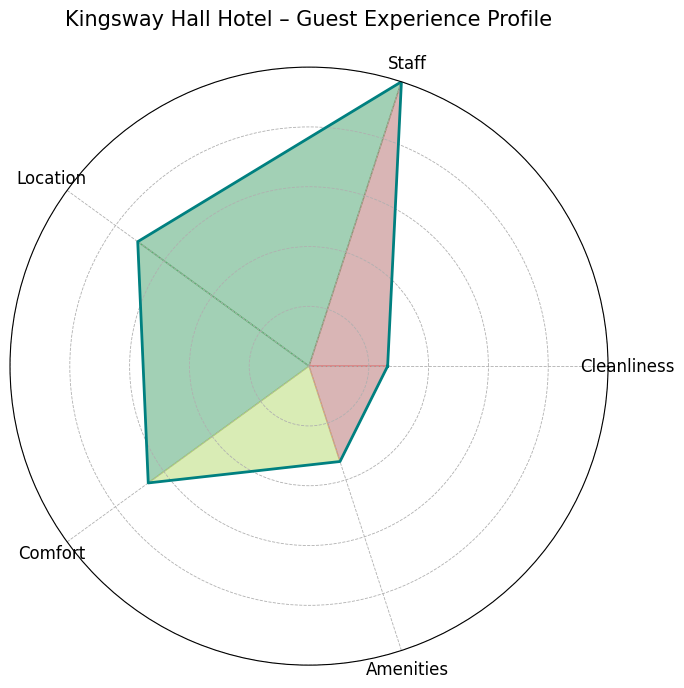

In [ ]:
generate_hotel_summary_cli()